In [8]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact
from matplotlib.animation import FuncAnimation

In [9]:
def plot_linear_equation(m=1, b=0):
    x = np.linspace(-10, 10, 100)
    y = m * x + b

    plt.figure(figsize=(8, 6))
    plt.plot(x, y, label=f"y = {m}x + {b}", color="blue")
    plt.axhline(0, color='black',linewidth=0.5)
    plt.axvline(0, color='black',linewidth=0.5)
    plt.grid(color = 'gray', linestyle = '--', linewidth = 0.5)
    plt.title("Linear Equation Visualization")
    plt.xlabel("x")
    plt.ylabel("y")
    plt.legend()
    plt.show()


interact(plot_linear_equation, m=(-100, 100, 1), b=(-100, 100, 1))


interactive(children=(IntSlider(value=1, description='m', min=-100), IntSlider(value=0, description='b', min=-…

<function __main__.plot_linear_equation(m=1, b=0)>

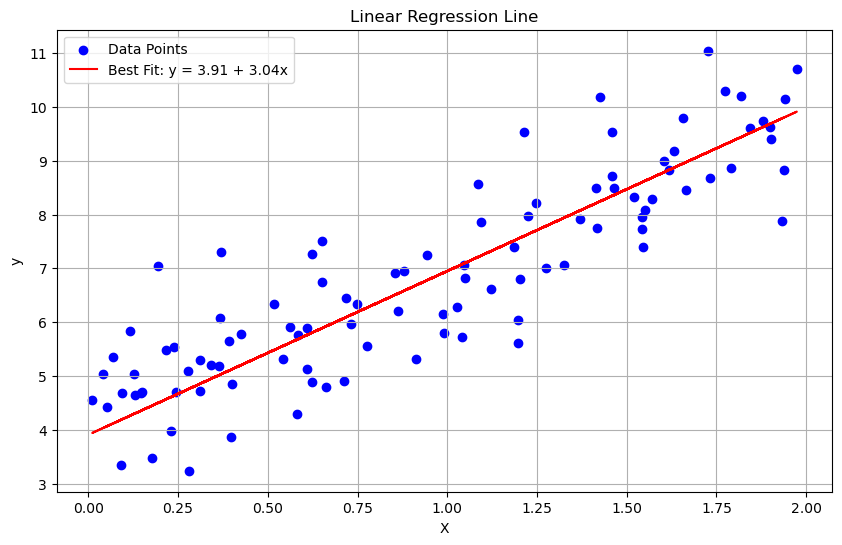

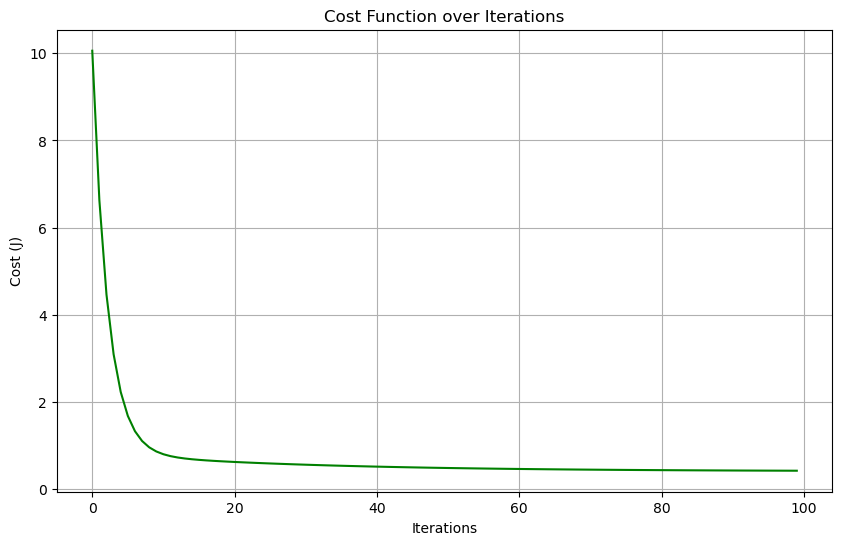

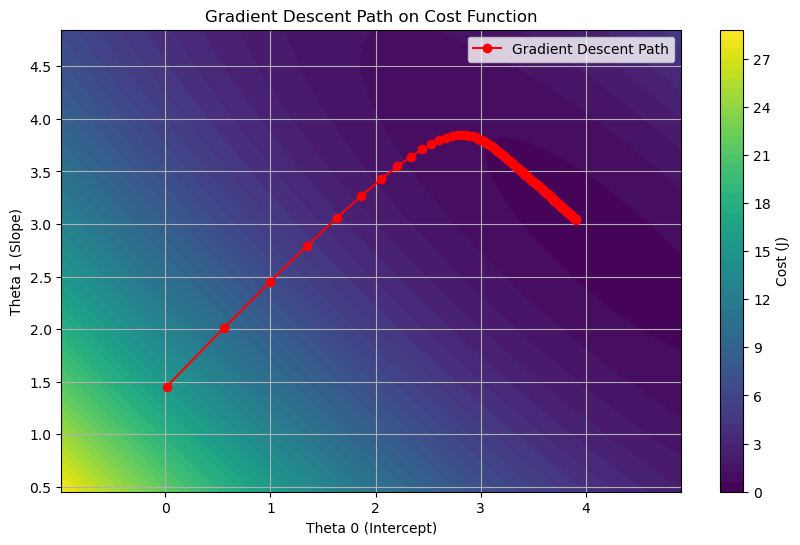

In [10]:

np.random.seed(42)
X = 2 * np.random.rand(100, 1)
y = 4 + 3 * X + np.random.randn(100, 1)

X_b = np.c_[np.ones((100, 1)), X]

def compute_cost(theta, X, y):
    m = len(y)
    predictions = X.dot(theta)
    cost = (1 / (2 * m)) * np.sum((predictions - y) ** 2)
    return cost

def gradient_descent(X, y, theta, learning_rate, n_iterations):
    m = len(y)
    cost_history = []
    theta_history = [theta.copy()]

    for _ in range(n_iterations):
        gradients = (1 / m) * X.T.dot(X.dot(theta) - y)
        theta -= learning_rate * gradients
        cost_history.append(compute_cost(theta, X, y))
        theta_history.append(theta.copy())

    return theta, cost_history, theta_history

theta_initial = np.random.randn(2, 1)
learning_rate = 0.1
n_iterations = 100

theta_best, cost_history, theta_history = gradient_descent(X_b, y, theta_initial, learning_rate, n_iterations)

plt.figure(figsize=(10, 6))
plt.scatter(X, y, color="blue", label="Data Points")
plt.plot(X, X_b.dot(theta_best), color="red", label=f"Best Fit: y = {theta_best[0][0]:.2f} + {theta_best[1][0]:.2f}x")
plt.title("Linear Regression Line")
plt.xlabel("X")
plt.ylabel("y")
plt.legend()
plt.grid()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(range(n_iterations), cost_history, color="green")
plt.title("Cost Function over Iterations")
plt.xlabel("Iterations")
plt.ylabel("Cost (J)")
plt.grid()
plt.show()

theta_0_vals = [theta[0][0] for theta in theta_history]
theta_1_vals = [theta[1][0] for theta in theta_history]

theta_0_range = np.linspace(min(theta_0_vals) - 1, max(theta_0_vals) + 1, 100)
theta_1_range = np.linspace(min(theta_1_vals) - 1, max(theta_1_vals) + 1, 100)

T0, T1 = np.meshgrid(theta_0_range, theta_1_range)
J_vals = np.array([
    compute_cost(np.array([[t0], [t1]]), X_b, y)
    for t0, t1 in zip(np.ravel(T0), np.ravel(T1))
]).reshape(T0.shape)

plt.figure(figsize=(10, 6))
plt.contourf(T0, T1, J_vals, levels=50, cmap="viridis")
plt.plot(theta_0_vals, theta_1_vals, color="red", marker="o", label="Gradient Descent Path")
plt.colorbar(label="Cost (J)")
plt.title("Gradient Descent Path on Cost Function")
plt.xlabel("Theta 0 (Intercept)")
plt.ylabel("Theta 1 (Slope)")
plt.legend()
plt.grid()
plt.show()


In [11]:
import numpy as np
import plotly.graph_objects as go

np.random.seed(42)
X = 2 * np.random.rand(100, 1)
y = 4 + 3 * X + np.random.randn(100, 1)

X_b = np.c_[np.ones((100, 1)), X]

theta = np.random.randn(2, 1)

learning_rate = 0.1
n_iterations = 100

theta_history = [theta.copy()]

def gradient_descent_step(theta, X_b, y):
    gradients = 2 / len(X_b) * X_b.T.dot(X_b.dot(theta) - y)
    return theta - learning_rate * gradients

for _ in range(n_iterations):
    theta = gradient_descent_step(theta, X_b, y)
    theta_history.append(theta.copy())

theta_history = np.array(theta_history)

fig = go.Figure()

fig.add_trace(go.Scatter(x=X.flatten(), y=y.flatten(), mode='markers', name='Data points'))

fig.add_trace(go.Scatter(x=X.flatten(), y=X_b.dot(theta_history[0]).flatten(), mode='lines', name='Initial Regression Line'))

frames = []
for i in range(1, len(theta_history)):
    frames.append(
        go.Frame(
            data=[
                go.Scatter(x=X.flatten(), y=y.flatten(), mode='markers', name='Data points'),
                go.Scatter(x=X.flatten(), y=X_b.dot(theta_history[i]).flatten(), mode='lines', name=f'Iteration {i}')
            ],
            name=f'Frame {i}'
        )
    )

fig.frames = frames

fig.update_layout(
    title='Gradient Descent: Linear Regression Animation',
    xaxis_title='X',
    yaxis_title='y',
    updatemenus=[{
        'type': 'buttons',
        'buttons': [
            {
                'label': 'Play',
                'method': 'animate',
                'args': [None, {'frame': {'duration': 100, 'redraw': True}, 'fromcurrent': True}]
            },
            {
                'label': 'Pause',
                'method': 'animate',
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate'}]
            }
        ]
    }]
)

fig.show()

In [12]:

import plotly.graph_objects as go

np.random.seed(42)
X = 2 * np.random.rand(100, 1)
y = 4 + 3 * X + np.random.randn(100, 1)

X_b = np.c_[np.ones((100, 1)), X]

def compute_cost(theta, X, y):
    m = len(y)
    predictions = X.dot(theta)
    cost = (1 / (2 * m)) * np.sum((predictions - y) ** 2)
    return cost

def gradient_descent(X, y, theta, learning_rate, n_iterations):
    m = len(y)
    cost_history = []

    for _ in range(n_iterations):
        gradients = (1 / m) * X.T.dot(X.dot(theta) - y)
        theta -= learning_rate * gradients
        cost_history.append(compute_cost(theta, X, y))

    return cost_history

theta_initial = np.random.randn(2, 1)
learning_rate = 0.1
n_iterations = 100

cost_history = gradient_descent(X_b, y, theta_initial, learning_rate, n_iterations)

frames = []
for i in range(n_iterations):
    frame = go.Frame(
        data=[
            go.Scatter(x=list(range(i + 1)), y=cost_history[:i + 1], mode="lines+markers", line=dict(color="green")),
        ]
    )
    frames.append(frame)

fig = go.Figure(
    data=[
        go.Scatter(x=[0], y=[cost_history[0]], mode="lines+markers", line=dict(color="green")),
    ],
    layout=go.Layout(
        title="Cost Function Animation",
        xaxis=dict(title="Iterations"),
        yaxis=dict(title="Cost (J)"),
        updatemenus=[
            dict(
                type="buttons",
                showactive=False,
                buttons=[
                    dict(label="Play", method="animate", args=[None, dict(frame=dict(duration=200, redraw=True), fromcurrent=True)]),
                    dict(label="Pause", method="animate", args=[None, dict(mode="immediate", frame=dict(duration=0, redraw=False))]),
                ],
            )
        ],
    ),
    frames=frames,
)

fig.show()


In [13]:
import plotly.graph_objects as go

np.random.seed(42)
X = 2 * np.random.rand(100, 1)
y = 4 + 3 * X + np.random.randn(100, 1)

X_b = np.c_[np.ones((100, 1)), X]

def compute_cost(theta, X, y):
    m = len(y)
    predictions = X.dot(theta)
    cost = (1 / (2 * m)) * np.sum((predictions - y) ** 2)
    return cost

def compute_gradient(theta, X, y):
    m = len(y)
    return (1 / m) * X.T.dot(X.dot(theta) - y)

theta_0_vals = np.linspace(-1, 7, 100)
theta_1_vals = np.linspace(-1, 5, 100)
T0, T1 = np.meshgrid(theta_0_vals, theta_1_vals)

Z = np.array([
    compute_cost(np.array([[t0], [t1]]), X_b, y)
    for t0, t1 in zip(np.ravel(T0), np.ravel(T1))
]).reshape(T0.shape)

def gradient_descent(X, y, theta, learning_rate, n_iterations):
    theta_history = [theta.copy()]
    cost_history = [compute_cost(theta, X, y)]

    for _ in range(n_iterations):
        gradient = compute_gradient(theta, X, y)
        theta -= learning_rate * gradient
        theta_history.append(theta.copy())
        cost_history.append(compute_cost(theta, X, y))

    return theta, cost_history, theta_history

theta_initial = np.random.randn(2, 1)
learning_rate = 0.1
n_iterations = 50

theta_best, cost_history, theta_history = gradient_descent(X_b, y, theta_initial, learning_rate, n_iterations)

frames = []
for i in range(len(theta_history)):
    theta = theta_history[i]
    frame = go.Frame(
        data=[
            go.Surface(z=Z, x=theta_0_vals, y=theta_1_vals, colorscale="Viridis", showscale=False, opacity=0.8),
            go.Scatter3d(
                x=[theta[0][0]],
                y=[theta[1][0]],
                z=[cost_history[i]],
                mode="markers",
                marker=dict(size=8, color="red"),
                name="Gradient Step",
            ),
        ]
    )
    frames.append(frame)

fig = go.Figure(
    data=[
        go.Surface(z=Z, x=theta_0_vals, y=theta_1_vals, colorscale="Viridis", showscale=False, opacity=0.8),
        go.Scatter3d(
            x=[theta_history[0][0][0]],
            y=[theta_history[0][1][0]],
            z=[cost_history[0]],
            mode="markers",
            marker=dict(size=8, color="red"),
            name="Gradient Step",
        ),
    ],
    layout=go.Layout(
        title="Gradient Descent Optimization",
        scene=dict(
            xaxis_title="Theta 0",
            yaxis_title="Theta 1",
            zaxis_title="Cost (J)",
        ),
        updatemenus=[
            dict(
                type="buttons",
                showactive=False,
                buttons=[
                    dict(label="Play", method="animate", args=[None, dict(frame=dict(duration=200, redraw=True), fromcurrent=True)]),
                    dict(label="Pause", method="animate", args=[None, dict(mode="immediate", frame=dict(duration=0, redraw=False))]),
                ],
            )
        ],
    ),
    frames=frames,
)

fig.show()


In [14]:
import numpy as np
import plotly.graph_objects as go

np.random.seed(42)
X = 2 * np.random.rand(100, 1)
y = 4 + 3 * X + np.random.randn(100, 1)

X_b = np.c_[np.ones((100, 1)), X]

def compute_cost(theta, X, y):
    m = len(y)
    predictions = X.dot(theta)
    cost = (1 / (2 * m)) * np.sum((predictions - y) ** 2)
    return cost

def compute_gradient(theta, X, y):
    m = len(y)
    return (1 / m) * X.T.dot(X.dot(theta) - y)

def gradient_descent(X, y, theta, learning_rate, n_iterations):
    theta_history = [theta.copy()]
    cost_history = [compute_cost(theta, X, y)]

    for _ in range(n_iterations):
        gradient = compute_gradient(theta, X, y)
        theta -= learning_rate * gradient
        theta_history.append(theta.copy())
        cost_history.append(compute_cost(theta, X, y))

    return theta_history, cost_history

theta_initial = np.random.randn(2, 1)
learning_rates = [0.01, 0.1, 0.5]
n_iterations = 50

results = {}
for lr in learning_rates:
    theta_history, cost_history = gradient_descent(X_b, y, theta_initial.copy(), lr, n_iterations)
    results[lr] = {"theta_history": theta_history, "cost_history": cost_history}

frames = []
for i in range(n_iterations):
    frame_data = []
    for lr, result in results.items():
        cost_history = result["cost_history"]
        frame_data.append(
            go.Scatter(
                x=list(range(i + 1)),
                y=cost_history[:i + 1],
                mode="lines+markers",
                name=f"Learning Rate = {lr}",
            )
        )
    frames.append(go.Frame(data=frame_data))

fig = go.Figure(
    data=[
        go.Scatter(
            x=[0], y=[results[lr]["cost_history"][0]],
            mode="lines+markers",
            name=f"Learning Rate = {lr}"
        ) for lr in learning_rates
    ],
    layout=go.Layout(
        title="Gradient Descent with Different Learning Rates (2D)",
        xaxis=dict(title="Iterations"),
        yaxis=dict(title="Cost (J)"),
        updatemenus=[
            dict(
                type="buttons",
                showactive=True,
                buttons=[
                    dict(
                        label="Play",
                        method="animate",
                        args=[None, dict(frame=dict(duration=200, redraw=True), fromcurrent=True)],
                    ),
                    dict(
                        label="Pause",
                        method="animate",
                        args=[None, dict(frame=dict(duration=0, redraw=False))],
                    ),
                ],
            )
        ],
    ),
    frames=frames,
)

fig.show()


In [15]:
import numpy as np
import plotly.graph_objects as go

def cost_function(w):
    return w**2

def cost_gradient(w):
    return 2 * w

def gradient_descent(initial_weight, learning_rate, n_iterations):
    weights = [initial_weight]
    for _ in range(n_iterations):
        gradient = cost_gradient(weights[-1])
        new_weight = weights[-1] - learning_rate * gradient
        weights.append(new_weight)
    return weights

#
initial_weight = 5
n_iterations = 20

learning_rates = [0.1, 0.8]

results = {lr: gradient_descent(initial_weight, lr, n_iterations) for lr in learning_rates}

frames = []
for i in range(n_iterations + 1):
    frame_data = []
    for lr, weights in results.items():
        frame_data.append(
            go.Scatter(
                x=weights[:i+1],
                y=[cost_function(w) for w in weights[:i+1]],
                mode="lines+markers",
                name=f"Learning Rate = {lr}",
                marker=dict(size=8),
            )
        )
    frames.append(go.Frame(data=frame_data))

fig = go.Figure(
    data=[
        go.Scatter(
            x=[initial_weight],
            y=[cost_function(initial_weight)],
            mode="lines+markers",
            name=f"Learning Rate = {lr}",
            marker=dict(size=8),
        ) for lr in learning_rates
    ],
    layout=go.Layout(
        title="Gradient Descent with Small and Large Learning Rates",
        xaxis=dict(title="Value of Weight"),
        yaxis=dict(title="Loss"),
        updatemenus=[
            dict(
                type="buttons",
                showactive=True,
                buttons=[
                    dict(
                        label="Play",
                        method="animate",
                        args=[None, dict(frame=dict(duration=300, redraw=True), fromcurrent=True)],
                    ),
                    dict(
                        label="Pause",
                        method="animate",
                        args=[None, dict(frame=dict(duration=0, redraw=False))],
                    ),
                ],
            )
        ],
    ),
    frames=frames,
)

fig.show()
